In [ ]:
import os
import random
import shutil

import cv2
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
from brisque import BRISQUE
from torch.utils.data import DataLoader, Dataset, Subset, random_split
from torchvision import models
from torchvision.utils import save_image
from tqdm.notebook import tqdm

random_seed = 123

random.seed(random_seed)
np.random.seed(random_seed)
torch.manual_seed(random_seed)
torch.cuda.manual_seed(random_seed)
torch.cuda.manual_seed_all(random_seed)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False
os.environ["PYTHONHASHSEED"] = str(random_seed)
os.environ["OPENCV_IO_ENABLE_OPENEXR"] = "1"


In [ ]:
def compute_contrast_image(
    image_tensor: torch.Tensor, kernel_size: int = 7, gaussian_sigma: float = 0.5
) -> torch.Tensor:
    """
    Compute local contrast of an image using Gaussian filtering.

    Args:
        image_tensor: Input tensor of shape (B, C, H, W)
        kernel_size: Size of the Gaussian kernel (default: 7)
        gaussian_sigma: Standard deviation for Gaussian filter (default: 0.5)

    Returns:
        torch.Tensor: Contrast image tensor of same shape as input
    """
    batch_size, channels, height, width = image_tensor.shape

    # Create 1D Gaussian kernel
    kernel_coords = (
        torch.arange(kernel_size, dtype=image_tensor.dtype, device=image_tensor.device)
        - kernel_size // 2
    )

    gaussian_1d = torch.exp(-(kernel_coords**2) / (2 * gaussian_sigma**2))
    gaussian_1d = gaussian_1d / gaussian_1d.sum()

    # Create 2D Gaussian kernel
    gaussian_2d = torch.outer(gaussian_1d, gaussian_1d)
    gaussian_filter = gaussian_2d.expand(channels, 1, kernel_size, kernel_size)

    # Compute local statistics
    padding = kernel_size // 2
    local_mean = F.conv2d(
        image_tensor, gaussian_filter, padding=padding, groups=channels
    )

    image_squared = image_tensor * image_tensor
    local_mean_squared = F.conv2d(
        image_squared, gaussian_filter, padding=padding, groups=channels
    )

    # Calculate local contrast
    contrast = torch.sqrt((local_mean_squared - local_mean**2).clamp(min=1e-10))
    return contrast


def display_tensor_images(
    image_tensor: torch.Tensor,
    max_images: int = 5,
    figure_title: str = "",
    figure_size: tuple[int, int] = (12, 6),
) -> None:
    """
    Display a set of tensor images using matplotlib.

    Args:
        image_tensor: Input tensor of shape (B, C, H, W) or (C, H, W)
        max_images: Maximum number of images to display (default: 5)
        figure_title: Title for the figure (default: "")
        figure_size: Size of the figure in inches (default: (12, 6))
    """
    # Prepare tensor
    tensor = image_tensor.detach().cpu()
    if tensor.ndim == 3:
        tensor = tensor.unsqueeze(0)
    elif tensor.ndim != 4:
        raise ValueError(f"Expected 3D or 4D tensor, got shape {tensor.shape}")

    batch_size = tensor.size(0)
    num_display_images = min(max_images, batch_size)

    # Create figure
    plt.figure(figsize=figure_size)
    if figure_title:
        plt.suptitle(figure_title, fontsize=16)

    # Display images
    for idx in range(num_display_images):
        image = tensor[idx]
        image = torch.clamp(image, 0, 1)
        image_array = image.permute(1, 2, 0).numpy()

        plt.subplot(1, num_display_images, idx + 1)
        plt.imshow(image_array)
        plt.axis("off")

    plt.tight_layout()
    plt.show()


In [ ]:
def normalize_by_mean(image: np.ndarray) -> np.ndarray:
    """
    Normalize an image by scaling it based on its mean value.

    Args:
        image: Input image array

    Returns:
        np.ndarray: Normalized image array
    """
    return 0.5 * image / image.mean()


def apply_ulaw_transform(image: np.ndarray) -> np.ndarray:
    """
    Apply u-law transformation to an image.

    Args:
        image: Input image array

    Returns:
        np.ndarray: Transformed image array
    """
    median_value = np.median(image)
    scale = 8.759 * np.power(median_value, 2.148) + 0.1494 * np.power(
        median_value, -2.067
    )
    transformed = np.log(1 + scale * image) / np.log(1 + scale)
    return transformed


def load_and_process_hdr_image(file_path: str) -> tuple[np.ndarray, np.ndarray]:
    """
    Load an HDR image and process it into u-law and RGB formats.

    Args:
        file_path: Path to the HDR image file

    Returns:
        Tuple[np.ndarray, np.ndarray]: Processed u-law and RGB images
    """
    # Load image with full depth and color
    raw_image = cv2.imread(file_path, flags=cv2.IMREAD_ANYDEPTH | cv2.IMREAD_ANYCOLOR)

    # Convert to RGB and ensure non-negative values
    rgb_image = np.maximum(cv2.cvtColor(raw_image, cv2.COLOR_BGR2RGB), 0.0)

    # Apply normalization and transformation
    normalized_rgb = normalize_by_mean(rgb_image)
    ulaw_image = apply_ulaw_transform(normalized_rgb)

    return ulaw_image, normalized_rgb


class HDRImageDataset(Dataset):
    """Dataset class for loading and processing HDR images."""

    def __init__(self, root_directory: str):
        """
        Initialize the HDR dataset.

        Args:
            root_directory: Directory containing HDR image files
        """
        self.root_directory = root_directory
        self.image_files = [
            filename
            for filename in os.listdir(root_directory)
            if filename.endswith(".exr")
        ]

    def __len__(self) -> int:
        """Return the total number of images in the dataset."""
        return len(self.image_files)

    def __getitem__(self, index: int) -> dict[str, torch.Tensor]:
        """
        Get a processed image sample from the dataset.

        Args:
            index: Index of the image to retrieve

        Returns:
            Dict containing processed tensors and filename
        """
        if torch.is_tensor(index):
            index = index.tolist()

        image_path = os.path.join(self.root_directory, self.image_files[index])
        ulaw_image, rgb_image = load_and_process_hdr_image(image_path)

        # Convert to PyTorch tensors and adjust dimensions
        ulaw_tensor = torch.from_numpy(ulaw_image).float().permute(2, 0, 1)
        rgb_tensor = torch.from_numpy(rgb_image).float().permute(2, 0, 1)

        return {
            "y_ulaw": ulaw_tensor,
            "y_rgb": rgb_tensor,
            "filename": self.image_files[index],
        }


In [ ]:
def compute_multi_exposure_images(image: torch.Tensor) -> list[torch.Tensor]:
    """
    Generate multiple exposure versions of an image using logarithmic scaling.
    
    Args:
        image: Input tensor representing the image
        
    Returns:
        List of tensors with different exposure levels
    """
    # Constants
    BASE_EXPOSURE = 1.21497
    BASE_TWO = torch.tensor(2.0, device=image.device)

    # Calculate exposure coefficients
    start_coeff = torch.log(
        (BASE_EXPOSURE / torch.max(image)) / torch.log(BASE_TWO)
    )
    end_coeff = torch.log(
        (BASE_EXPOSURE / torch.quantile(image, 0.5)) / torch.log(BASE_TWO)
    )
    
    # Define exposure values
    exposure_values = [
        start_coeff,
        (start_coeff + end_coeff) / 2.0,
        end_coeff
    ]
    
    # Generate exposure-adjusted images
    exposed_images = []
    for exp_value in exposure_values:
        scale_factor = torch.pow(torch.sqrt(BASE_TWO), exp_value)
        adjusted_image = image * scale_factor
        clamped_image = torch.where(
            adjusted_image > 1.0,
            torch.ones_like(adjusted_image),
            adjusted_image
        )
        exposed_images.append(clamped_image)
    
    return exposed_images

def generate_scaled_exposures(
    image: torch.Tensor,
    scale_factors: list[float] = [0.4, 1.0, 1.5]
) -> list[torch.Tensor]:
    """
    Generate multiple exposure versions of an image using predefined scale factors.
    
    Args:
        image: Input tensor representing the image
        scale_factors: List of scaling factors for exposure adjustment (default: [0.4, 1.0, 1.5])
        
    Returns:
        List of tensors with different exposure levels
    """
    exposed_images = []
    for scale in scale_factors:
        scaled_image = image * scale
        clamped_image = torch.clamp(scaled_image, 0.0, 1.0)
        exposed_images.append(clamped_image)
    
    return exposed_images


In [ ]:
class VGGFeatureExtractor(nn.Module):
    """Extracts features from specified VGG layers for perceptual loss computation."""

    def __init__(self, target_layers: list[str], vgg_version: str = "vgg19"):
        """
        Initialize the VGG feature extractor.

        Args:
            target_layers: List of layer names to extract features from
            vgg_version: Version of VGG to use ('vgg19' or 'vgg16')
        """
        super().__init__()
        self.target_layers = target_layers

        # Initialize VGG model
        if vgg_version == "vgg19":
            vgg_model = models.vgg19(weights=models.VGG19_Weights.DEFAULT).features
        elif vgg_version == "vgg16":
            vgg_model = models.vgg16(weights=models.VGG16_Weights.DEFAULT).features
        else:
            raise ValueError(f"Unsupported VGG version: {vgg_version}")

        self.feature_network = vgg_model.eval()
        self._freeze_parameters()

        # Setup hooks for feature extraction
        self.feature_outputs: dict[str, torch.Tensor] = {}
        self._register_hooks()

    def _freeze_parameters(self) -> None:
        """Disable gradient computation for all parameters."""
        for parameter in self.feature_network.parameters():
            parameter.requires_grad = False

    def _create_hook(self, layer_name: str) -> callable:
        """Create a forward hook to capture layer outputs."""

        def hook(module: nn.Module, input: torch.Tensor, output: torch.Tensor) -> None:
            self.feature_outputs[layer_name] = output

        return hook

    def _register_hooks(self) -> None:
        """Register forward hooks for target layers."""
        layer_dict = dict(self.feature_network._modules)
        for layer_name in self.target_layers:
            layer = layer_dict[layer_name]
            layer.register_forward_hook(self._create_hook(layer_name))

    def forward(self, input_tensor: torch.Tensor) -> dict[str, torch.Tensor]:
        """
        Extract features from the input tensor.

        Args:
            input_tensor: Input image tensor

        Returns:
            Dictionary mapping layer names to their feature outputs
        """
        _ = self.feature_network(input_tensor)
        return {name: self.feature_outputs[name] for name in self.target_layers}


class ContrastivePerceptualLoss(nn.Module):
    """Computes perceptual loss based on contrast features from VGG network."""

    def __init__(
        self,
        target_layers: list[str],
        layer_weights: list[float],
        vgg_version: str = "vgg19",
    ):
        """
        Initialize the contrastive perceptual loss module.

        Args:
            target_layers: List of VGG layer names to use
            layer_weights: Weights for each layer's contribution
            vgg_version: Version of VGG to use ('vgg19' or 'vgg16')

        Raises:
            ValueError: If number of weights doesn't match number of layers
        """
        if len(target_layers) != len(layer_weights):
            raise ValueError(
                f"Expected {len(target_layers)} weights, got {len(layer_weights)}"
            )
        super().__init__()

        self.feature_extractor = VGGFeatureExtractor(target_layers, vgg_version)
        self.loss_function = nn.L1Loss()
        self.layer_weights = layer_weights

    def forward(
        self, predicted_image: torch.Tensor, target_image: torch.Tensor
    ) -> torch.Tensor:
        """
        Compute the contrastive perceptual loss between two images.

        Args:
            predicted_image: Model output image tensor
            target_image: Ground truth image tensor

        Returns:
            Computed loss value
        """
        predicted_features = self.feature_extractor(predicted_image)
        target_features = self.feature_extractor(target_image)

        total_loss = 0.0
        for idx, layer_name in enumerate(predicted_features):
            predicted_contrast = compute_contrast_image(predicted_features[layer_name])
            target_contrast = compute_contrast_image(target_features[layer_name])
            layer_loss = self.loss_function(predicted_contrast, target_contrast)
            total_loss += self.layer_weights[idx] * layer_loss

        return total_loss


In [ ]:
class Encoder(nn.Module):
    """Encodes input images into higher-dimensional feature representations."""

    def __init__(self, input_channels: int):
        """
        Initialize the encoder with convolutional layers.

        Args:
            input_channels: Number of input channels
        """
        super().__init__()

        self.conv_layer1 = nn.Conv2d(
            in_channels=input_channels,
            out_channels=16,
            kernel_size=3,
            stride=1,
            padding="same",
        )
        self.conv_layer2 = nn.Conv2d(
            in_channels=16, out_channels=32, kernel_size=3, stride=1, padding="same"
        )
        self.conv_layer3 = nn.Conv2d(
            in_channels=32, out_channels=64, kernel_size=3, stride=1, padding="same"
        )
        self.activation = nn.ReLU()

    def forward(self, input_tensor: torch.Tensor) -> torch.Tensor:
        """
        Process input through the encoder layers.

        Args:
            input_tensor: Input image tensor

        Returns:
            Encoded feature tensor
        """
        features1 = self.activation(self.conv_layer1(input_tensor))
        features2 = self.activation(self.conv_layer2(features1))
        features3 = self.activation(self.conv_layer3(features2))
        return features3


class Decoder(nn.Module):
    """Decodes features back to image space with residual connections."""

    def __init__(self, input_channels: int):
        """
        Initialize the decoder with convolutional layers.

        Args:
            input_channels: Number of input channels
        """
        super().__init__()

        self.conv_layer1 = nn.Conv2d(
            in_channels=input_channels,
            out_channels=32,
            kernel_size=3,
            stride=1,
            padding="same",
        )
        self.conv_layer2 = nn.Conv2d(
            in_channels=32, out_channels=16, kernel_size=3, stride=1, padding="same"
        )
        self.conv_layer3 = nn.Conv2d(
            in_channels=16, out_channels=3, kernel_size=3, stride=1, padding="same"
        )
        self.relu_activation = nn.ReLU()
        self.sigmoid_activation = nn.Sigmoid()

    def forward(
        self,
        encoded_features: torch.Tensor,
        exposure1: torch.Tensor,
        exposure2: torch.Tensor,
        exposure3: torch.Tensor,
    ) -> tuple[torch.Tensor, torch.Tensor]:
        """
        Decode features and combine with input exposures.

        Args:
            encoded_features: Features from encoder
            exposure1: First exposure input
            exposure2: Second exposure input
            exposure3: Third exposure input

        Returns:
            Tuple of final output and residual output
        """
        features1 = self.relu_activation(self.conv_layer1(encoded_features))
        features2 = self.relu_activation(self.conv_layer2(features1))
        features3 = self.conv_layer3(features2)

        combined_output = features3 + exposure1 + exposure2 + exposure3
        final_output = self.sigmoid_activation(combined_output)

        return final_output, features3


class TMONet(nn.Module):
    """Tone Mapping Operator Network combining encoder and decoder."""

    def __init__(self, input_channels: int = 3):
        """
        Initialize the TMONet architecture.

        Args:
            input_channels: Number of input channels (default: 3)
        """
        super().__init__()

        self.encoder = Encoder(input_channels=input_channels)
        self.gated_conv1 = nn.Conv2d(
            in_channels=64 * 3, out_channels=64 * 3, kernel_size=3, stride=1, padding=1
        )
        self.gated_conv2 = nn.Conv2d(
            in_channels=64 * 3, out_channels=64 * 3, kernel_size=1, stride=1, padding=0
        )
        self.decoder = Decoder(input_channels=64 * 3)

    def forward(
        self, exposure1: torch.Tensor, exposure2: torch.Tensor, exposure3: torch.Tensor
    ) -> torch.Tensor:
        """
        Process multiple exposures through the network.

        Args:
            exposure1: First exposure input
            exposure2: Second exposure input
            exposure3: Third exposure input

        Returns:
            Final tone-mapped image
        """
        encoded1 = self.encoder(exposure1)
        encoded2 = self.encoder(exposure2)
        encoded3 = self.encoder(exposure3)

        concatenated_features = torch.cat([encoded1, encoded2, encoded3], dim=1)
        gated_features1 = self.gated_conv1(concatenated_features)
        gated_features2 = self.gated_conv2(gated_features1)

        final_image, _ = self.decoder(gated_features2, exposure1, exposure2, exposure3)
        return final_image


In [ ]:
def compute_luminance(image: np.ndarray) -> np.ndarray:
    """
    Calculate luminance from an RGB image using standard coefficients.

    Args:
        image: RGB image array with shape (H, W, 3)

    Returns:
        Luminance array with shape (H, W)
    """
    LUMINANCE_COEFFICIENTS = [0.299, 0.587, 0.114]
    return np.sum(image * LUMINANCE_COEFFICIENTS, axis=2)


def evaluate_image(image_tensor: torch.Tensor) -> float:
    """
    Evaluate image quality using BRISQUE metric.

    Args:
        image_tensor: Input image tensor in CHW format

    Returns:
        BRISQUE quality score
    """
    metric = BRISQUE(url=False)

    # Convert tensor to numpy array in HWC format
    image_array = image_tensor.cpu().detach().numpy()
    image_array = np.transpose(image_array, (1, 2, 0))

    # Validate image data
    if not np.isfinite(image_array).all():
        print(
            f"Warning: Image contains NaNs or Infs! Min: {image_array.min()}, Max: {image_array.max()}"
        )

    if (image_array < 0).any() or (image_array > 1).any():
        print(
            f"Warning: Image values outside [0,1] range! Min: {image_array.min()}, Max: {image_array.max()}"
        )

    # Convert to uint8 format
    processed_image = (image_array * 255).astype(np.uint8)
    return metric.score(img=processed_image)


def apply_reinhard_tone_mapping(hdr_image: np.ndarray) -> np.ndarray:
    """
    Apply Reinhard tone mapping to an HDR image.

    Args:
        hdr_image: HDR image array with shape (H, W, 3)

    Returns:
        Tone-mapped image array with shape (H, W, 3)
    """
    EPSILON = 1e-8

    # Compute luminance and logarithmic average
    luminance = compute_luminance(hdr_image)
    log_average_luminance = np.exp(np.mean(np.log(luminance + EPSILON)))

    # Scale luminance
    luminance_scale = 1.0 / log_average_luminance
    scaled_luminance = (luminance * luminance_scale) / (
        1.0 + luminance * luminance_scale
    )

    # Apply tone mapping to each channel
    tone_mapped_image = np.zeros_like(hdr_image)
    for channel in range(3):
        tone_mapped_image[:, :, channel] = (
            hdr_image[:, :, channel] / (luminance + EPSILON)
        ) * scaled_luminance

    return np.clip(tone_mapped_image, 0, 1)


In [ ]:
class ModelTrainer:
    """Handles the training process for the TMONet model."""

    def __init__(self, config: dict[str, object]):
        """Initialize trainer with configuration."""
        self.config = config
        self.device = torch.device(config["device"])
        self.model = TMONet(input_channels=3).to(self.device)
        self.loss_function = ContrastivePerceptualLoss(
            target_layers=["0", "5", "10", "19"], layer_weights=[1.0, 0.8, 0.7, 0.5]
        ).to(self.device)
        self.optimizer = torch.optim.Adam(
            self.model.parameters(), lr=config["learning_rate"]
        )
        self.lr_scheduler = torch.optim.lr_scheduler.StepLR(
            self.optimizer, step_size=10, gamma=config["lr_decay"]
        )

    def _create_data_loaders(self) -> tuple[DataLoader, DataLoader]:
        """Create training and validation data loaders."""
        dataset = HDRImageDataset(root_directory=self.config["data_dir"])

        if self.config["single_image_mode"]:
            train_subset = Subset(dataset, [0])
            val_subset = Subset(dataset, [0])
        else:
            train_size = int((1 - self.config["validation_split"]) * len(dataset))
            val_size = len(dataset) - train_size
            train_subset, val_subset = random_split(dataset, [train_size, val_size])

        train_loader = DataLoader(
            train_subset,
            batch_size=self.config["batch_size"],
            shuffle=not self.config["single_image_mode"],
        )
        val_loader = DataLoader(
            val_subset, batch_size=self.config["batch_size"], shuffle=False
        )
        return train_loader, val_loader

    def _setup_output_directory(self) -> None:
        """Prepare output directory structure."""
        output_path = self.config["output_dir"]
        shutil.rmtree(output_path, ignore_errors=True)
        os.makedirs(output_path, exist_ok=True)
        os.makedirs(os.path.join(output_path, "reference"), exist_ok=True)

    def _compute_reference_metrics(
        self, val_loader: DataLoader
    ) -> tuple[float, torch.Tensor]:
        """Compute baseline metrics using Reinhard tone mapping."""
        brisque_total = 0.0
        sample_count = 0
        reference_image = None

        with torch.no_grad():
            for batch_idx, batch in enumerate(val_loader):
                hdr_rgb = batch["y_rgb"].float().to(self.device)
                for i in range(hdr_rgb.size(0)):
                    hdr_array = hdr_rgb[i].cpu().numpy().transpose(1, 2, 0)
                    tone_mapped_array = apply_reinhard_tone_mapping(hdr_array)
                    tone_mapped_tensor = torch.from_numpy(
                        tone_mapped_array.transpose(2, 0, 1)
                    ).float()

                    image_path = os.path.join(
                        self.config["output_dir"],
                        "reference",
                        f"val_{batch_idx * self.config['batch_size'] + i}.png",
                    )
                    save_image(tone_mapped_tensor, image_path)

                    if batch_idx + i == 0:
                        reference_image = tone_mapped_tensor

                    brisque_total += evaluate_image(tone_mapped_tensor)
                    sample_count += 1

        baseline_score = brisque_total / sample_count if sample_count > 0 else 0.0
        return baseline_score, reference_image

    def _train_epoch(self, train_loader: DataLoader, progress_bar: tqdm) -> float:
        """Train the model for one epoch."""
        self.model.train()
        total_loss = 0.0

        for step, batch in enumerate(train_loader):
            target = batch["y_ulaw"].float().to(self.device)
            input_rgb = batch["y_rgb"].float().to(self.device)

            self.optimizer.zero_grad()
            exposures = generate_scaled_exposures(input_rgb)
            prediction = self.model(exposures[0], exposures[1], exposures[2])

            loss = self.loss_function(prediction, target)
            loss.backward()
            self.optimizer.step()

            total_loss += loss.item()
            progress_bar.set_postfix(
                epoch=f"{self.config['current_epoch']}/{self.config['epochs']}",
                stage="Training",
                loss=total_loss / (step + 1),
            )
            progress_bar.update(1)

        return total_loss / len(train_loader)

    def _validate_epoch(
        self, val_loader: DataLoader, progress_bar: tqdm
    ) -> tuple[float, float, torch.Tensor]:
        """Validate the model and compute metrics."""
        self.model.eval()
        total_loss = 0.0
        total_brisque = 0.0
        sample_count = 0
        display_image = None

        with torch.no_grad():
            for batch_idx, batch in enumerate(val_loader):
                target = batch["y_ulaw"].float().to(self.device)
                input_rgb = batch["y_rgb"].float().to(self.device)

                exposures = generate_scaled_exposures(input_rgb)
                prediction = self.model(exposures[0], exposures[1], exposures[2])

                loss = self.loss_function(prediction, target)
                total_loss += loss.item() * prediction.size(0)

                for i in range(prediction.size(0)):
                    target_array = target[i].cpu().numpy().transpose(1, 2, 0)
                    pred_array = prediction[i].cpu().numpy().transpose(1, 2, 0)

                    target_lum = compute_luminance(target_array)
                    pred_lum = compute_luminance(pred_array)
                    color_ratio = (target_array / (target_lum[..., None] + 1e-8)) ** 0.6
                    output_array = np.clip(color_ratio * pred_lum[..., None], 0, 1)
                    output_tensor = torch.from_numpy(
                        output_array.transpose(2, 0, 1)
                    ).float()

                    image_path = os.path.join(
                        self.config["output_dir"],
                        f"{self.config['current_epoch']}",
                        f"{batch_idx * self.config['batch_size'] + i}.png",
                    )
                    save_image(output_tensor, image_path)

                    if batch_idx + i == 0:
                        display_image = output_tensor

                    total_brisque += evaluate_image(output_tensor)
                    sample_count += 1

                progress_bar.set_postfix(
                    epoch=f"{self.config['current_epoch']}/{self.config['epochs']}",
                    stage="Validation",
                )
                progress_bar.update(1)

        return total_loss / sample_count, total_brisque / sample_count, display_image

    def train(self) -> None:
        """Execute the complete training process."""
        self._setup_output_directory()
        train_loader, val_loader = self._create_data_loaders()

        batches_per_epoch = len(train_loader) + (
            len(val_loader) if self.config["valid_step"] > 0 else 0
        )
        total_batches = batches_per_epoch * self.config["epochs"]

        with tqdm(
            total=total_batches, desc="Training Progress", unit="batch"
        ) as progress_bar:
            baseline_score, reference_image = self._compute_reference_metrics(
                val_loader
            )

            for epoch in range(1, self.config["epochs"] + 1):
                self.config["current_epoch"] = epoch
                train_loss = self._train_epoch(train_loader, progress_bar)

                if epoch % self.config["valid_step"] == 0:
                    os.makedirs(
                        os.path.join(self.config["output_dir"], f"{epoch}"),
                        exist_ok=True,
                    )
                    val_loss, brisque_score, display_image = self._validate_epoch(
                        val_loader, progress_bar
                    )

                    print(
                        f"\nEpoch {epoch}/{self.config['epochs']} - Validation Metrics:"
                    )
                    print(f"  Training Loss: {train_loss:.4f}")
                    print(f"  Validation Loss: {val_loss:.4f}")
                    print(f"  Validation BRISQUE Score: {brisque_score:.4f}")
                    print(f"  Reinhard BRISQUE Score: {baseline_score:.4f}")

                    comparison_images = torch.stack([display_image, reference_image])
                    display_tensor_images(
                        comparison_images, max_images=2, figure_title=f"Epoch {epoch}"
                    )

                    progress_bar.set_postfix(
                        epoch=f"{epoch}/{self.config['epochs']}",
                        stage="Validation",
                        loss_val=val_loss,
                        loss_train=train_loss,
                        brisque_val=brisque_score,
                        brisque_val_reinhard=baseline_score,
                    )

                self.lr_scheduler.step()


def train_model(config: dict[str, object]) -> None:
    """Wrapper function to initiate training."""
    trainer = ModelTrainer(config)
    trainer.train()


Loaded 181 HDR images
Batch keys: dict_keys(['y_ulaw', 'y_rgb', 'filename'])
y_ulaw shape: torch.Size([2, 3, 256, 256])
y_rgb shape: torch.Size([2, 3, 256, 256])
Filenames: ['171.exr', '062.exr']


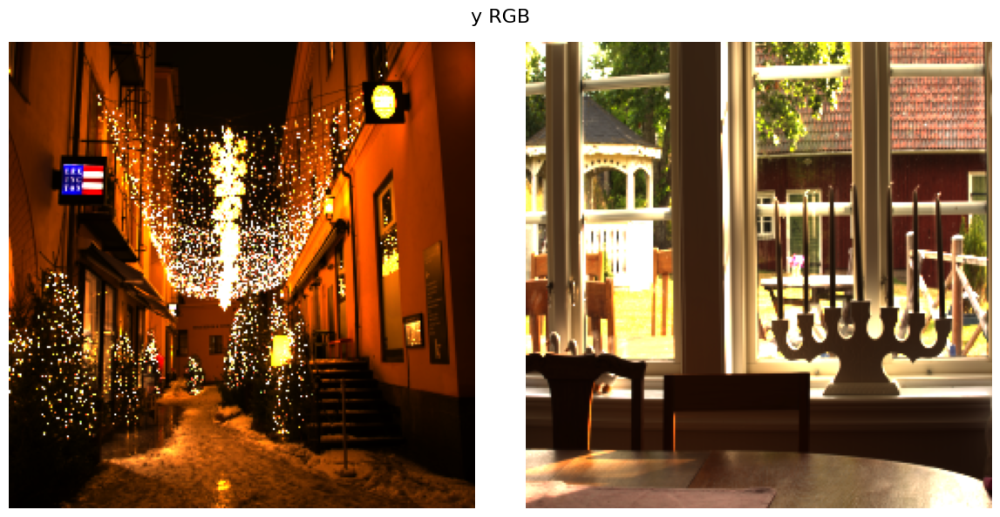

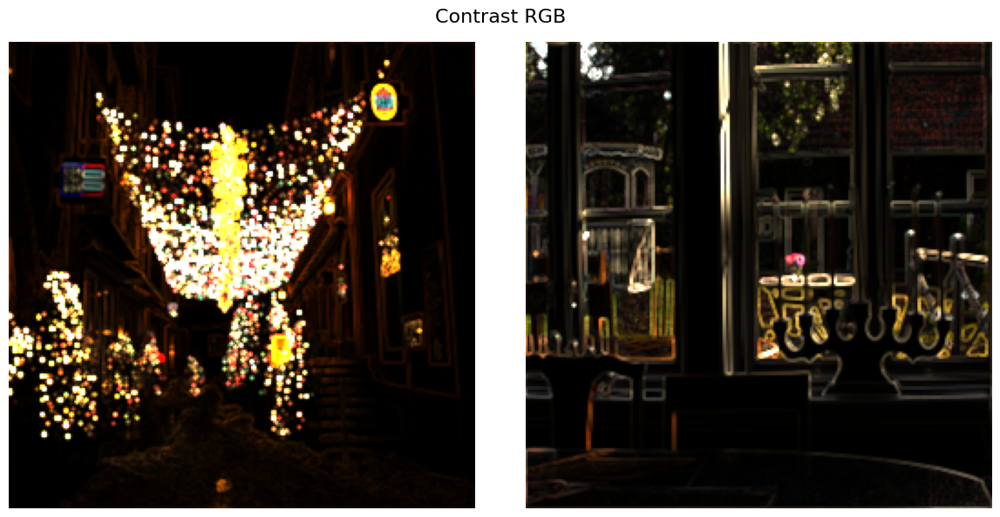

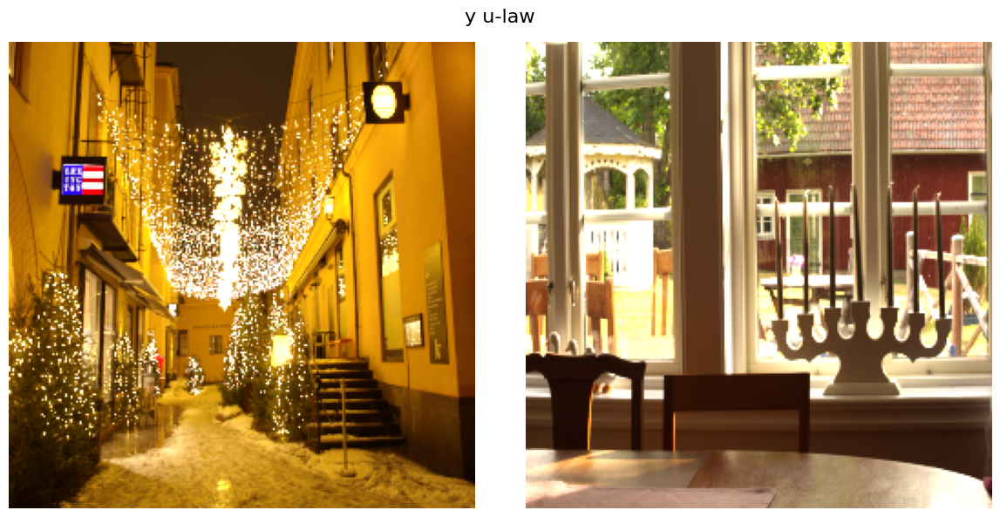

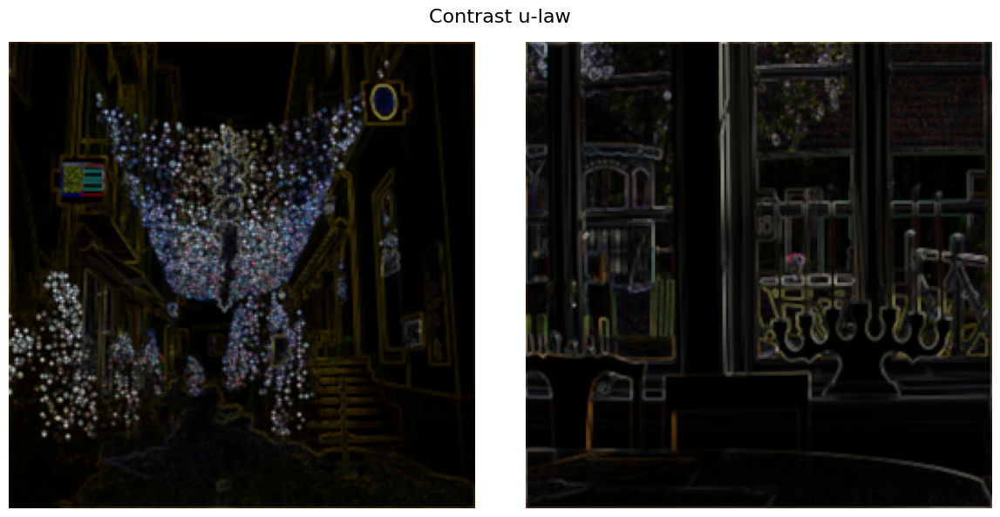

In [ ]:
dataset = HDRImageDataset(root_directory="data_resized")
print(f"Loaded {len(dataset)} HDR images")
dataloader = DataLoader(dataset, batch_size=2, shuffle=True)

for batch in dataloader:
    print("Batch keys:", batch.keys())
    print("y_ulaw shape:", batch["y_ulaw"].shape)
    print("y_rgb shape:", batch["y_rgb"].shape)
    print("Filenames:", batch["filename"])
    display_tensor_images(batch["y_rgb"], figure_title="y RGB")
    display_tensor_images(compute_contrast_image(batch["y_rgb"]), figure_title="Contrast RGB")
    display_tensor_images(batch["y_ulaw"], figure_title="y u-law")
    display_tensor_images(
        compute_contrast_image(batch["y_ulaw"]), figure_title="Contrast u-law"
    )
    break


Loaded 181 HDR images


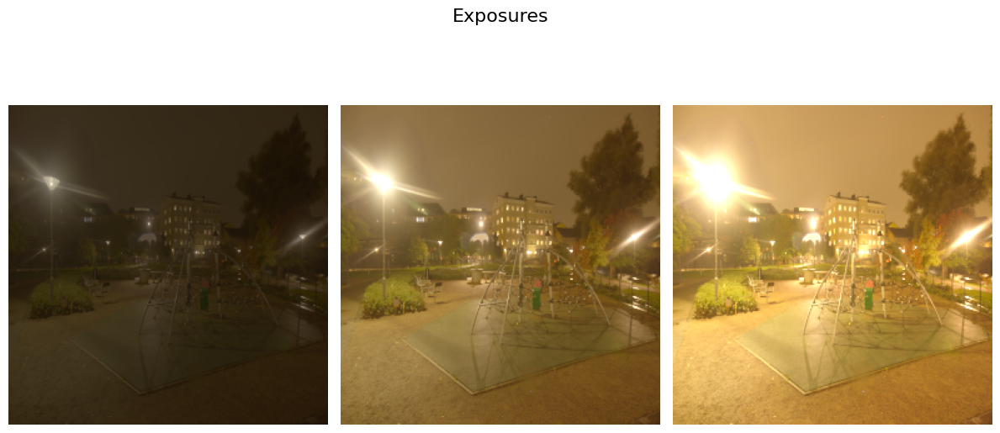

In [ ]:
dataset = HDRImageDataset(root_directory="data_resized")
print(f"Loaded {len(dataset)} HDR images")
dataloader = DataLoader(dataset, batch_size=1, shuffle=True)

for batch in dataloader:
    output_list = generate_scaled_exposures(batch["y_ulaw"])
    transformed_output = torch.stack(output_list, dim=0)
    A, B, C, H, W = transformed_output.shape
    transformed_output = transformed_output.view(A*B, C, H, W)
    display_tensor_images(transformed_output, figure_title="Exposures")
    break


In [ ]:
loss_fn = ContrastivePerceptualLoss(target_layers=['0', '5', '10'], layer_weights=[1.0, 0.8, 0.7])
dataset = HDRImageDataset(root_directory="data_resized")
print(f"Loaded {len(dataset)} HDR images")
dataloader = DataLoader(dataset, batch_size=2, shuffle=True)
for batch in dataloader:
    print("CPLoss:", loss_fn(batch["y_rgb"], batch["y_ulaw"]))
    break


Loaded 181 HDR images
CPLoss: tensor(0.4732)


Training Progress:   0%|          | 0/910 [00:00<?, ?batch/s]


Epoch 1/10 - Validation Metrics:
  Training Loss: 0.4005
  Validation Loss: 0.3395
  Validation BRISQUE Score: 27.5003
  Reinhard BRISQUE Score: 20.6040


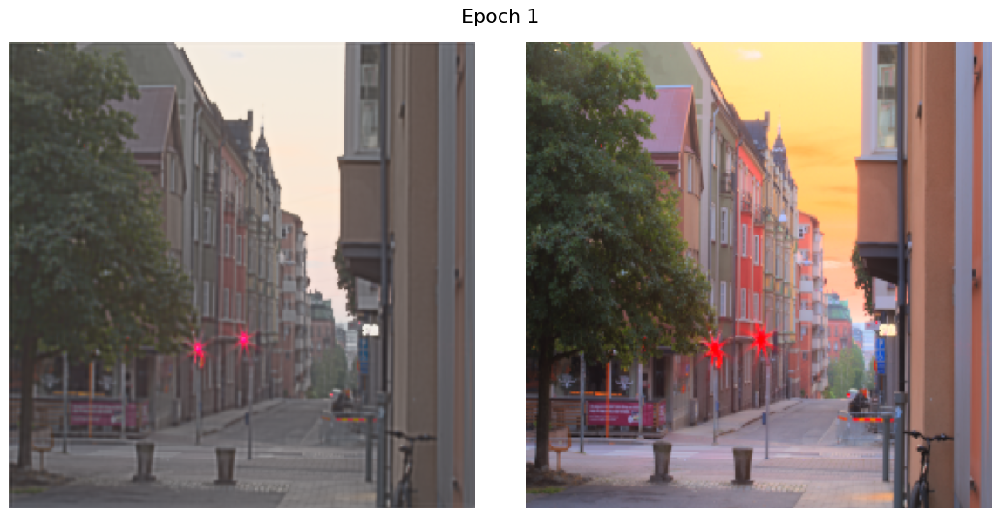


Epoch 2/10 - Validation Metrics:
  Training Loss: 0.3062
  Validation Loss: 0.2835
  Validation BRISQUE Score: 18.9251
  Reinhard BRISQUE Score: 20.6040


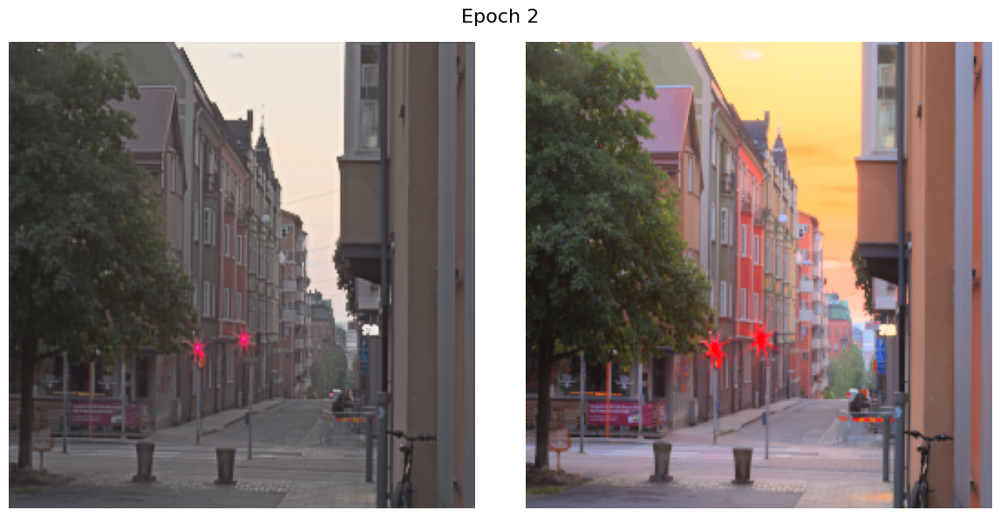


Epoch 3/10 - Validation Metrics:
  Training Loss: 0.2784
  Validation Loss: 0.3048
  Validation BRISQUE Score: 22.3932
  Reinhard BRISQUE Score: 20.6040


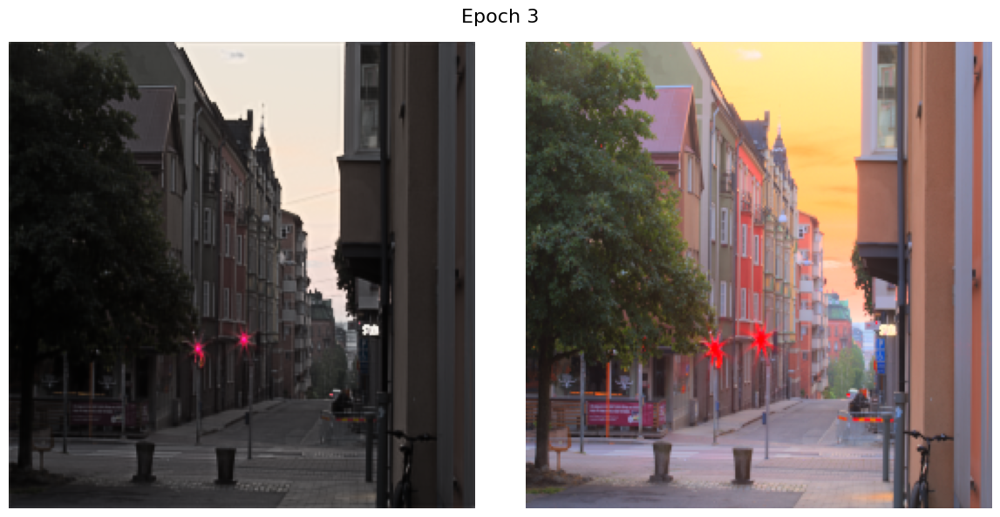


Epoch 4/10 - Validation Metrics:
  Training Loss: 0.2741
  Validation Loss: 0.2688
  Validation BRISQUE Score: 17.1262
  Reinhard BRISQUE Score: 20.6040


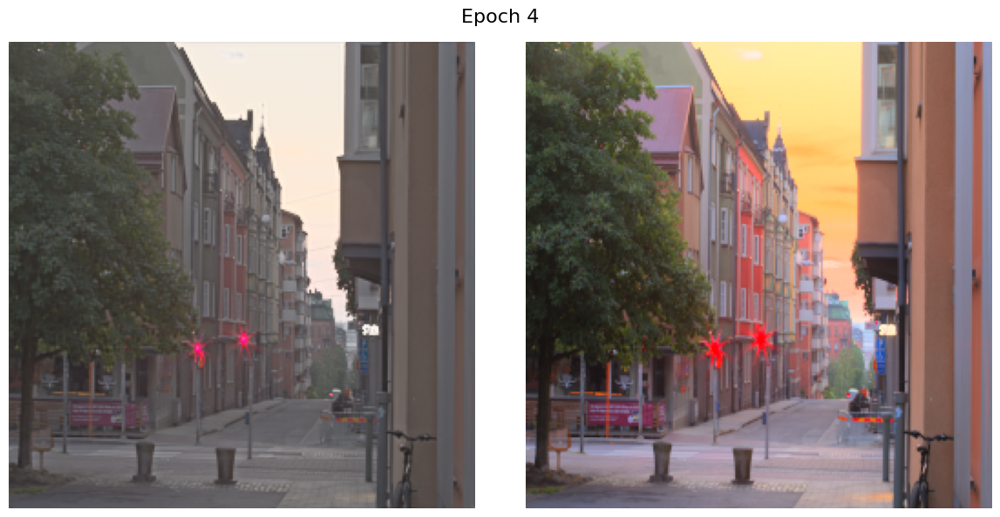


Epoch 5/10 - Validation Metrics:
  Training Loss: 0.2606
  Validation Loss: 0.2544
  Validation BRISQUE Score: 17.4059
  Reinhard BRISQUE Score: 20.6040


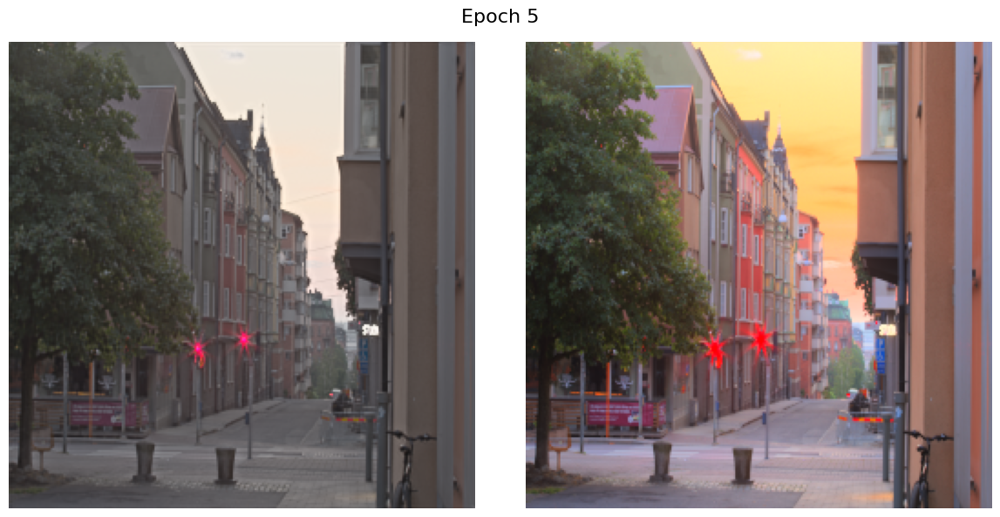


Epoch 6/10 - Validation Metrics:
  Training Loss: 0.2582
  Validation Loss: 0.2613
  Validation BRISQUE Score: 16.9729
  Reinhard BRISQUE Score: 20.6040


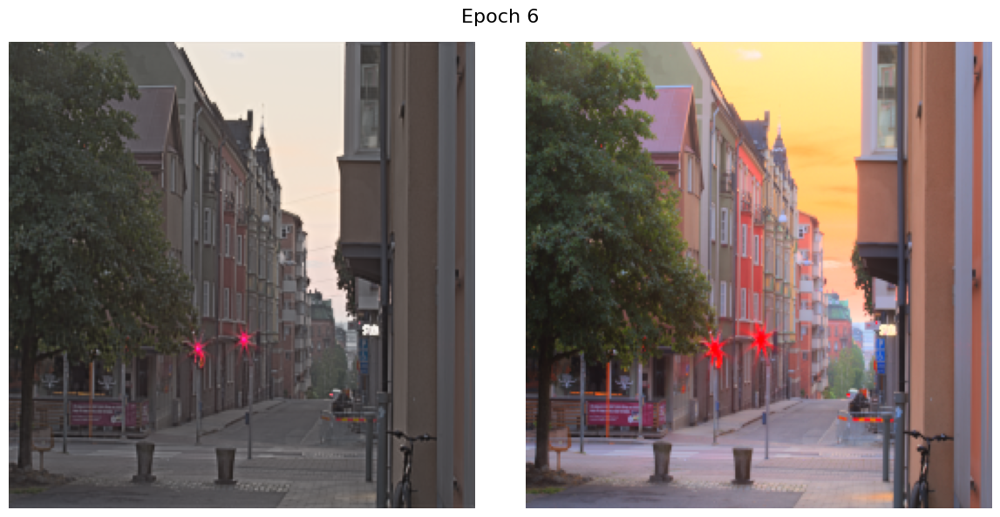


Epoch 7/10 - Validation Metrics:
  Training Loss: 0.2565
  Validation Loss: 0.2493
  Validation BRISQUE Score: 18.0123
  Reinhard BRISQUE Score: 20.6040


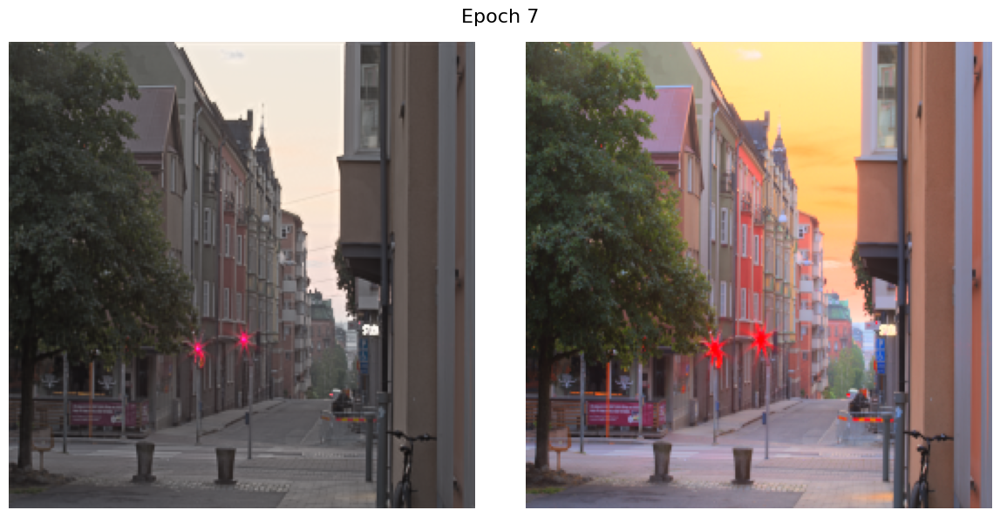


Epoch 8/10 - Validation Metrics:
  Training Loss: 0.2470
  Validation Loss: 0.2521
  Validation BRISQUE Score: 18.2814
  Reinhard BRISQUE Score: 20.6040


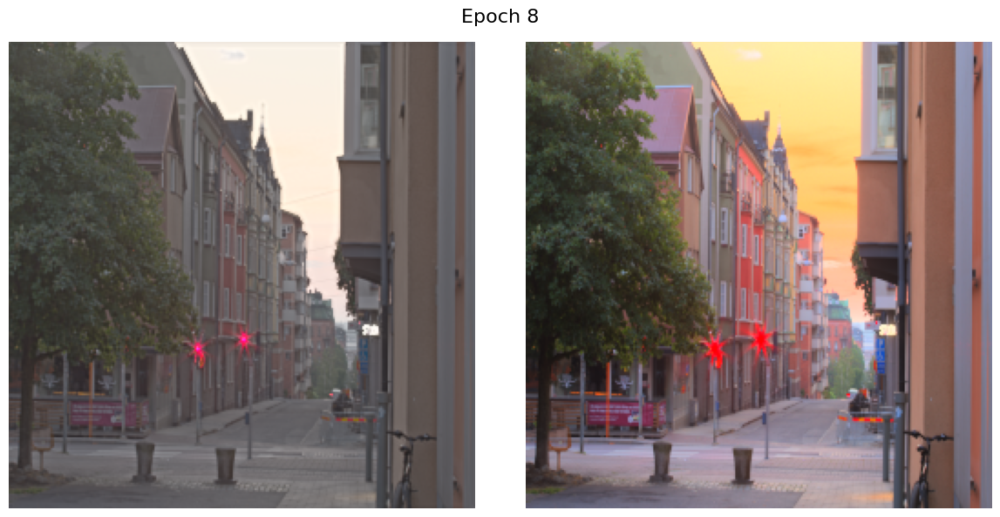


Epoch 9/10 - Validation Metrics:
  Training Loss: 0.2458
  Validation Loss: 0.2397
  Validation BRISQUE Score: 19.0082
  Reinhard BRISQUE Score: 20.6040


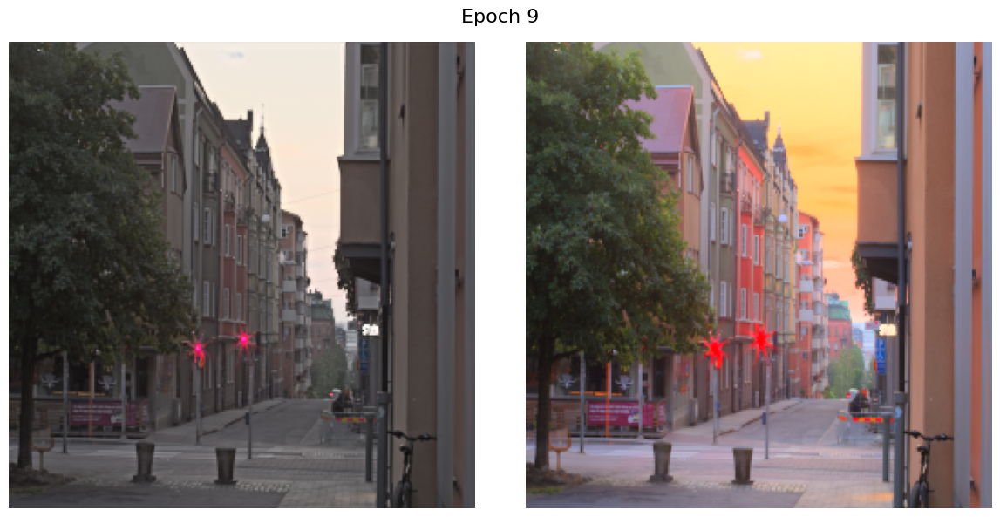


Epoch 10/10 - Validation Metrics:
  Training Loss: 0.2388
  Validation Loss: 0.2290
  Validation BRISQUE Score: 18.6270
  Reinhard BRISQUE Score: 20.6040


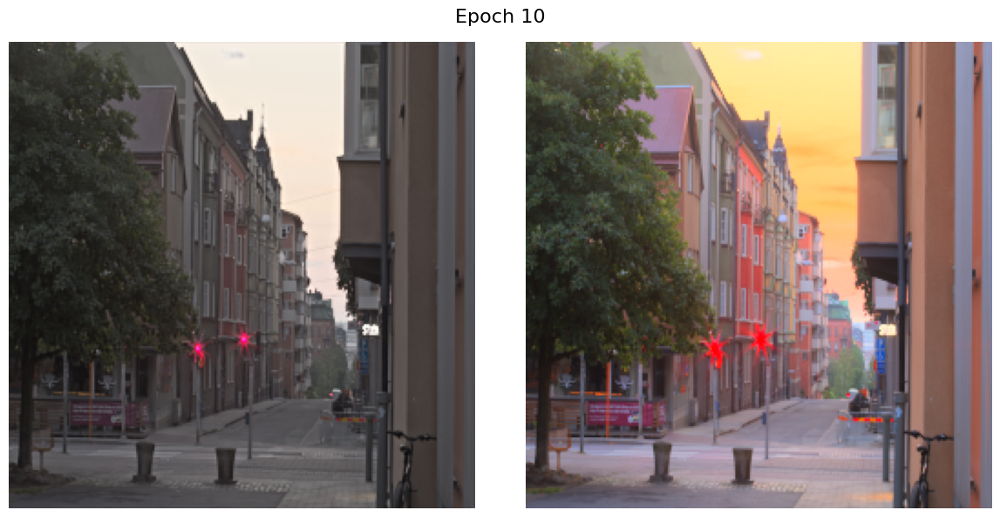

In [ ]:
config = {
    "epochs": 10,
    "batch_size": 2,
    "learning_rate": 1e-3,
    "data_dir": "data_resized",
    "validation_split": 0.2,
    "valid_step": 1,
    "device": "cuda" if torch.cuda.is_available() else "cpu",
    "output_dir": "output_images_multi",
    "lr_decay": 0.9,
    "single_image_mode": False,
}

train_model(config)


Training Progress:   0%|          | 0/1000 [00:00<?, ?batch/s]


Epoch 50/500 - Validation Metrics:
  Training Loss: 0.2287
  Validation Loss: 0.2271
  Validation BRISQUE Score: 11.9648
  Reinhard BRISQUE Score: 2.6875


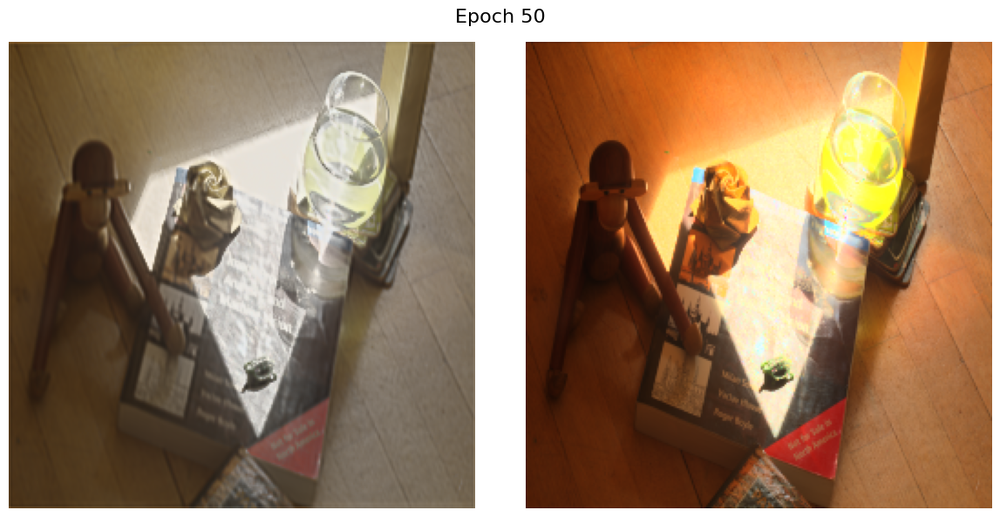


Epoch 100/500 - Validation Metrics:
  Training Loss: 0.1656
  Validation Loss: 0.1652
  Validation BRISQUE Score: 0.3106
  Reinhard BRISQUE Score: 2.6875


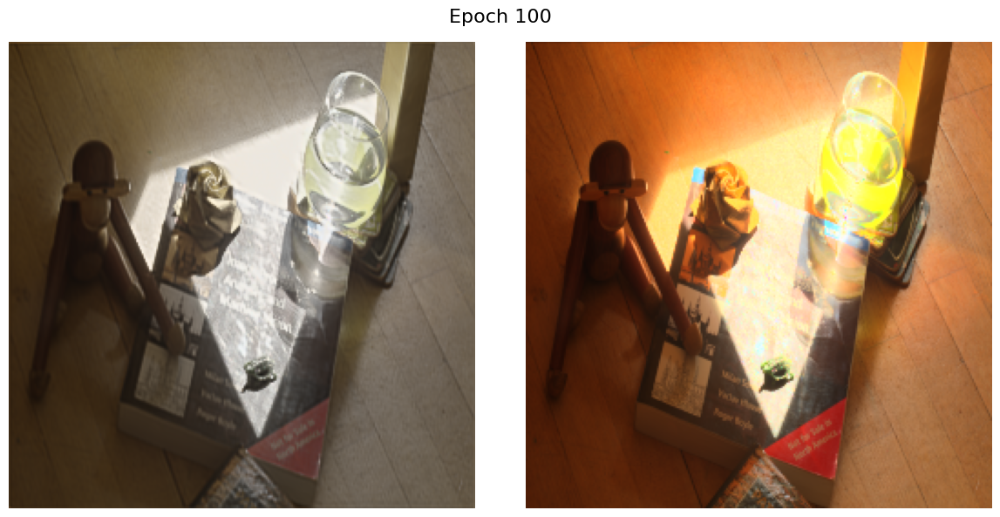


Epoch 150/500 - Validation Metrics:
  Training Loss: 0.1455
  Validation Loss: 0.1453
  Validation BRISQUE Score: -1.7035
  Reinhard BRISQUE Score: 2.6875


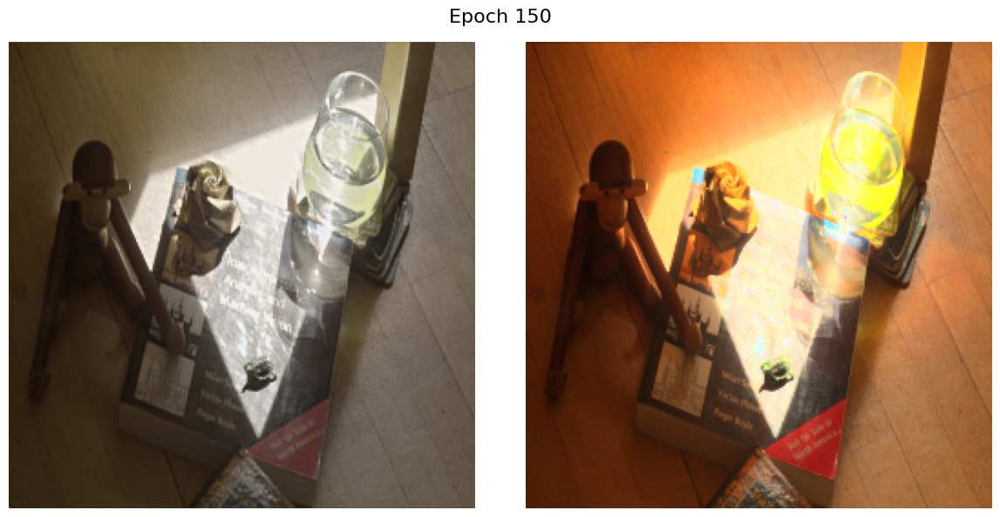


Epoch 200/500 - Validation Metrics:
  Training Loss: 0.1366
  Validation Loss: 0.1365
  Validation BRISQUE Score: -1.9552
  Reinhard BRISQUE Score: 2.6875


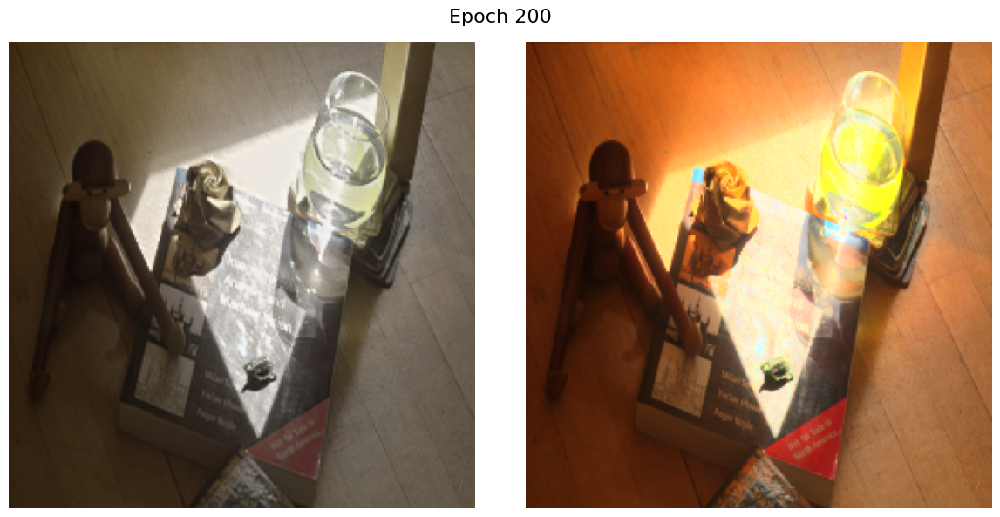


Epoch 250/500 - Validation Metrics:
  Training Loss: 0.1317
  Validation Loss: 0.1317
  Validation BRISQUE Score: -2.0836
  Reinhard BRISQUE Score: 2.6875


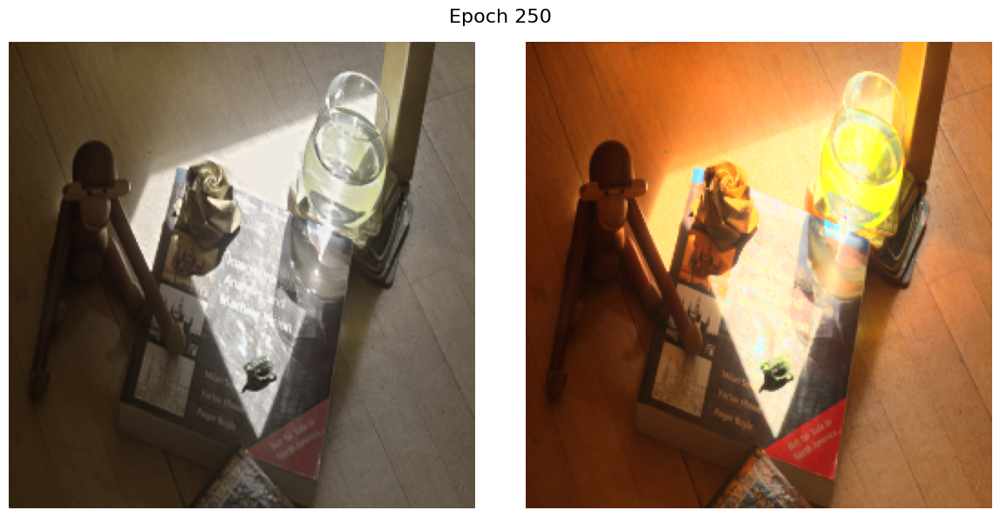


Epoch 300/500 - Validation Metrics:
  Training Loss: 0.1286
  Validation Loss: 0.1285
  Validation BRISQUE Score: -1.9595
  Reinhard BRISQUE Score: 2.6875


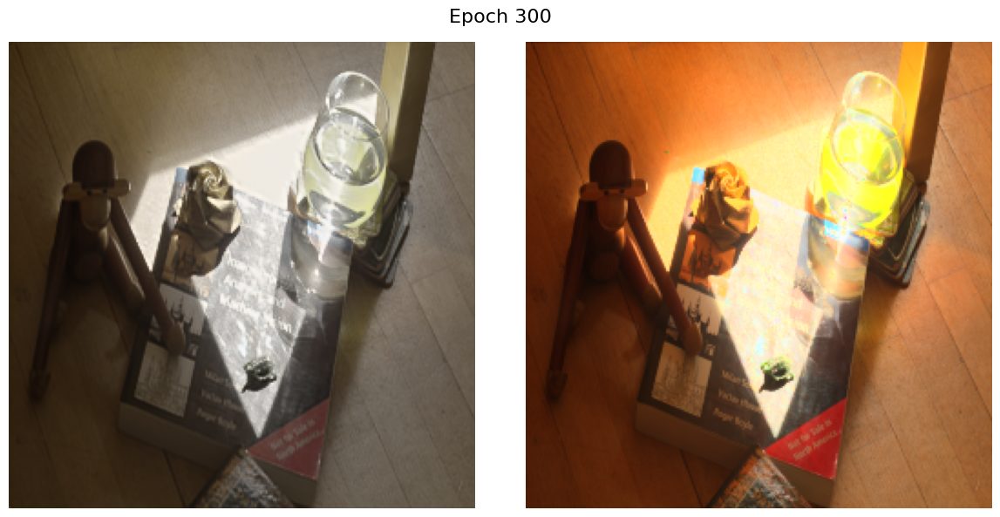


Epoch 350/500 - Validation Metrics:
  Training Loss: 0.1266
  Validation Loss: 0.1265
  Validation BRISQUE Score: -1.8918
  Reinhard BRISQUE Score: 2.6875


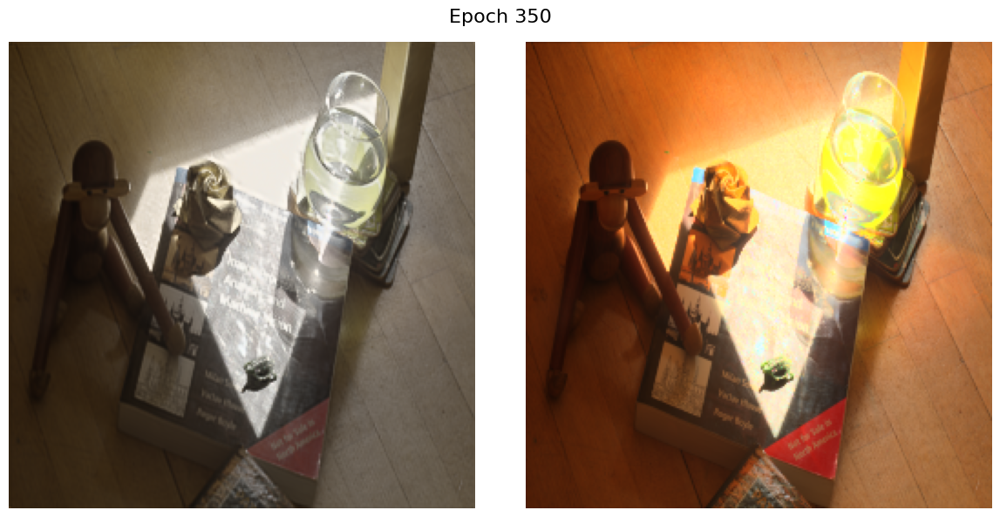


Epoch 400/500 - Validation Metrics:
  Training Loss: 0.1253
  Validation Loss: 0.1253
  Validation BRISQUE Score: -2.0952
  Reinhard BRISQUE Score: 2.6875


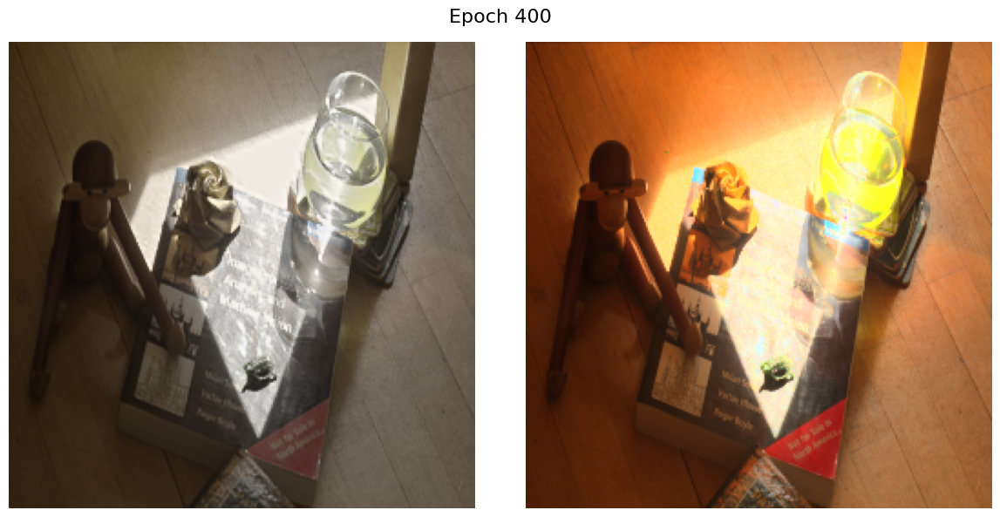


Epoch 450/500 - Validation Metrics:
  Training Loss: 0.1245
  Validation Loss: 0.1245
  Validation BRISQUE Score: -2.0842
  Reinhard BRISQUE Score: 2.6875


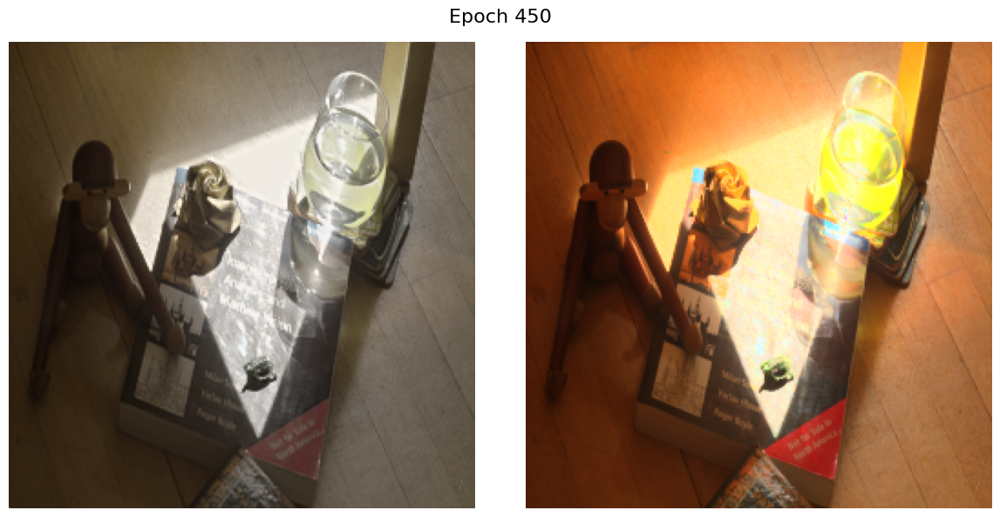


Epoch 500/500 - Validation Metrics:
  Training Loss: 0.1240
  Validation Loss: 0.1240
  Validation BRISQUE Score: -1.9725
  Reinhard BRISQUE Score: 2.6875


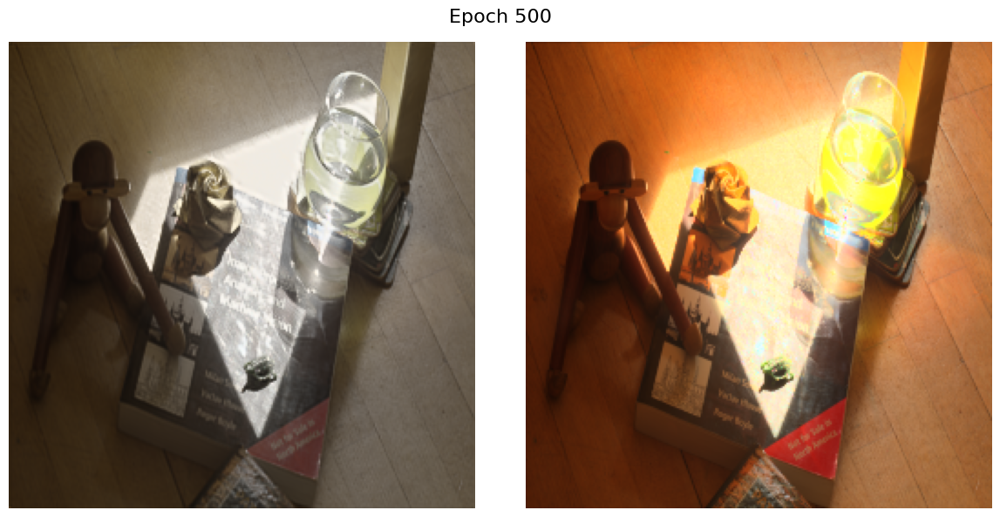

In [ ]:
config = {
    "epochs": 500,
    "batch_size": 1,
    "learning_rate": 1e-3,
    "data_dir": "data_resized",
    "validation_split": 0.2,
    "valid_step": 50,
    "device": "cuda" if torch.cuda.is_available() else "cpu",
    "output_dir": "output_images_single",
    "lr_decay": 0.9,
    "single_image_mode": True,
}

train_model(config)
